# **Disciplina de Tópicos Avançados - Visão Computacional - SCC0910**


#### **Bernardo Marques Costa - 11795551**
#### **Rodrigo Lopes Assaf -  11795530**
#### **Victor Henrique de Sa Silva - 11795759** 

## **Projeto - Face Generation**

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision.io import read_image
from torchvision.utils import make_grid
from torchvision.datasets import CelebA
from torchvision.transforms import transforms
from torch.utils.data import DataLoader

In [2]:
import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

### **Análise do Dataset - CelebA**

O dataset de atributos de faces de celebridades está disponível na plataforma Kaggle. Além disso, conseguimos extrair da biblioteca torchvision esse conjunto de dados. Assim, temos uma maior facilidade para explorar essa aplicação.

In [3]:
dataset = CelebA(root='./data', download=True)

Files already downloaded and verified


In [4]:
def plot_dataset(dataset, rows=2, cols=8):
    figure = plt.figure(figsize=(16,4))
    for i in range(1, rows * cols + 1):
        sample_idx = torch.randint(len(dataset), size=(1,)).item()
        img, label = dataset[sample_idx]
        figure.add_subplot(rows, cols, i)
        plt.axis('off')
        plt.imshow(img)

    plt.show()

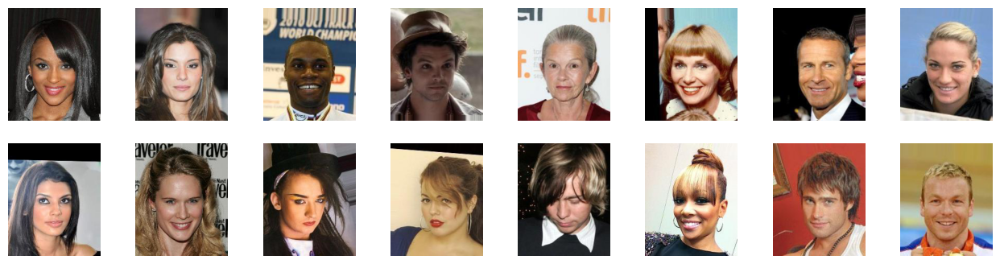

In [5]:
plot_dataset(dataset)

Podemos observar que as imagens são bem comportadas, com centralização dos rostos para facilitar utilização delas para o treinamento.

In [6]:
width, height = 0, 0
for image, _ in dataset:
    width += image.size[0]
    height += image.size[1]

In [7]:
print(f"Média de tamanho das imagens: ({width / len(dataset)}, {height / len(dataset)})")

Média de tamanho das imagens: (178.0, 218.0)


Observamos que também que todas as imagens possuem dimensionalidade 178 por 218. Assim, para treinar a nossa rede neural, iremos realizar a seguinte composição de transformações:
- Redimensionamento da imagem para 64x64
- Aplicamos um corte para centralizar a imagem
- Normalizamos as imagens

In [8]:
# Definimos as transformações que serão aplicadas nas imagens para construir os dados de treino
transform = transforms.Compose([
    transforms.Resize(64),
    transforms.CenterCrop(64),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])

Agora, com uma melhor noção dos dados, podemos partir para a criação da rede neural adversarial, criação do dataloader e treinamento do modelo.

### **Instanciando ambiente de execução**

In [9]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f'{device=}')

device='cuda'


### **Deep Convolutional Generative Adversarial Networks**

#### **Rede Adversarial Geradora**

Primeiramente, definimos aqui a classe da rede adversarial geradora, que como o próprio nome já diz, será responsável por gerar as imagens. A principio ela recebe um input de ruído, e retorna como output uma imagem 64x64.

In [10]:
# Definindo a arquitetura da rede geradora
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(100, 512, 4, 1, 0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(512, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),

            nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            nn.ConvTranspose2d(128, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),

            nn.ConvTranspose2d(64, 3, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)

#### **Rede Adversarial Discriminadora**


Em seguida, definimos aqui a classe da rede adversarial discriminadora, que como o próprio nome já diz, será responsável por discriminar as imagens entre real ou falsa. A principio ela recebe um input 64x64, e retorna como output único valor, correspondente compreendido como a probabilidade atribuída da imagem ser real ou falsa.

In [11]:
# Definindo a arquitetura da rede discriminadora
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(3, 64, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(64, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(128, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(256, 512, 4, 2, 1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(512, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input).view(-1, 1)

### **Treinamento do modelo**

In [12]:
# Definindo os parâmetros de treinamento
learning_rate = 0.0001
batch_size    = 128
num_epochs    = 50
beta1         = 0.5

#### **Função de custo**

Uma rede neural generativa adversarial deve ser treinada em etapas, uma vez que é uma otimização feita para duas redes. Treinamos o discriminazador para maximizar a probabilidade atribuir classes corretas tanto para os exemplos de treinamento quanto para as amostras feitas pelas rede geradora. Assim, treinamos o discriminador para minimizar a cross-entropy loss, isto é

$$\min_D\{-y\log D(x)-(1-y)\log(1-D(x))\}$$

Simultaneamente, treinamos a rede geradora para minimizar $\log(1-D(G(z)))$. Isto é, queremos que a resposta do discriminador para uma imagem gerada pelo gerador seja próximo de 1.  Assim, dado o discriminador D, atualizamos os parâmetros do gerador G para maximizar a entropia cruzada quando $y=0$:

$$\max_G\{-(1-y)\log(1-D(G(z)))\}=\max_G\{-\log(1-D(G(z)))\}$$

Se o gerador fizer um bom trabalho, então $D(x')\approx 1$, então a loss será próxima de 0, e o gradiente resultante será muito pequeno, a ponto de não existir mais progresso para o discriminador. Então comummente, minimizamos a seguinte loss

$$\min_G\{-y\log(D(G(z)))\}=\min_G\{-\log(D(G(z)))\}$$

Assim, a rede é treinada a partir de um jogo de minmax, com a seguinte função objetiva:

$$\min_D \max_G \{ -E_{x \sim \text{Data}} \log D(\mathbf x) - E_{z \sim \text{Noise}} \log(1 - D(G(\mathbf z))) \}$$ 

In [13]:
train_dataset    = CelebA(root='./data', transform=transform) # pegando os dados para o dataset de treino
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True) # construindo o dataloader

discriminator = Discriminator().to(device)
generator     = Generator().to(device)

# criando critério de otimização
criterion = nn.BCELoss()

# instanciando otimizadores das redes geradora e tora
optimizer_G = optim.Adam(generator.parameters(), lr=learning_rate, betas=(beta1, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=learning_rate, betas=(beta1, 0.999))

# Fixando ruído para fazer testes de faces
fixed_noise = torch.randn(64, 100, 1, 1, device=device)

G_losses = []
D_losses = []

#### **Rotina de treinamento da rede discriminadora**

In [14]:
def train_discriminator(discriminator, generator, criterion, optimizer, batch_size, real_images):
    # Treinando o discriminador com as imagens reais
    optimizer.zero_grad()
    
    label = torch.full((batch_size,), 1.0) + 0.05 * torch.randn((batch_size,))
    output = discriminator(real_images.to(device))
    err_real = criterion(output.squeeze(), label.to(device))
    err_real.backward()
    
    # Treinando o discriminador com as imagens geradas pela rede geradora
    noise = torch.randn(batch_size, 100, 1, 1, device=device)
    fake_images = generator(noise)
    label.fill_(0.0) 
    label += 0.05 * torch.randn((batch_size,))
    
    output = discriminator(fake_images.detach())
    err_fake = criterion(output.squeeze(), label.to(device))
    err_fake.backward()
    
    err = err_real + err_fake
    optimizer.step()

    return err, fake_images

#### **Rotina de treinamento da rede geradora**

In [15]:
def train_generator(discriminator, optimizer, criterion, batch_size, fake_images):
    # Treinando a rede geradora
    optimizer.zero_grad()

    label = torch.full((batch_size,), 1.0) + 0.05 * torch.randn((batch_size,))
    output = discriminator(fake_images)
    err = criterion(output.squeeze(), label.to(device))
    err.backward()
    optimizer.step()

    return err

In [16]:
def save_image(test_images, epoch, path):
    if not os.path.isdir(path):
        os.mkdir(path)
    if not os.path.isdir(os.path.join(path, epoch)):
        os.mkdir(os.path.join(path, epoch))
    for i, img in enumerate(test_images):
        image = np.clip(img, 0, 1)
        image = transforms.ToPILImage()(image)
        image.save(f'{path}/{epoch}/{i}.png')

In [17]:
# Treinando a GAN
for epoch in range(num_epochs):
    for i, data in enumerate(train_dataloader):
        real_images = data[0]
        batch_size = real_images.size(0)

        errD, fake_images = train_discriminator(discriminator, generator, criterion, optimizer_D, batch_size, real_images)
        errG = train_generator(discriminator, optimizer_G, criterion, batch_size, fake_images)
        
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        # Imprimindo as estatísticas do treinamento
        if i % 50 == 0:
            print(f"Epoch [{epoch}/{num_epochs}] Batch [{i}/{len(train_dataloader)}] "
                  f"Erro discriminador: {errD.item():.4f} Erro gerador: {errG.item():.4f}")

        if i == len(train_dataloader) // 2:
            with torch.no_grad():
                fake = generator(fixed_noise).detach().cpu()
            save_image(fake, f'{epoch}_half' , './images')

    # Salvando imagens geradas pela rede geradora a cada epoch
    with torch.no_grad():
        fake = generator(fixed_noise).detach().cpu()
    save_image(fake, str(epoch), './images')

Epoch [0/50] Batch [0/1272] Erro discriminador: 1.3819 Erro gerador: 1.6969
Epoch [0/50] Batch [50/1272] Erro discriminador: 0.0729 Erro gerador: 7.1993
Epoch [0/50] Batch [100/1272] Erro discriminador: 0.1944 Erro gerador: 12.2166
Epoch [0/50] Batch [150/1272] Erro discriminador: 0.1952 Erro gerador: 11.1447
Epoch [0/50] Batch [200/1272] Erro discriminador: 0.9606 Erro gerador: 1.1062
Epoch [0/50] Batch [250/1272] Erro discriminador: 0.2183 Erro gerador: 3.1142
Epoch [0/50] Batch [300/1272] Erro discriminador: 0.3530 Erro gerador: 4.4201
Epoch [0/50] Batch [350/1272] Erro discriminador: 0.4817 Erro gerador: 5.5180
Epoch [0/50] Batch [400/1272] Erro discriminador: 0.4869 Erro gerador: 4.8655
Epoch [0/50] Batch [450/1272] Erro discriminador: 0.2371 Erro gerador: 3.2342
Epoch [0/50] Batch [500/1272] Erro discriminador: 0.2437 Erro gerador: 3.5179
Epoch [0/50] Batch [550/1272] Erro discriminador: 0.7101 Erro gerador: 4.9048
Epoch [0/50] Batch [600/1272] Erro discriminador: 0.1157 Erro ger

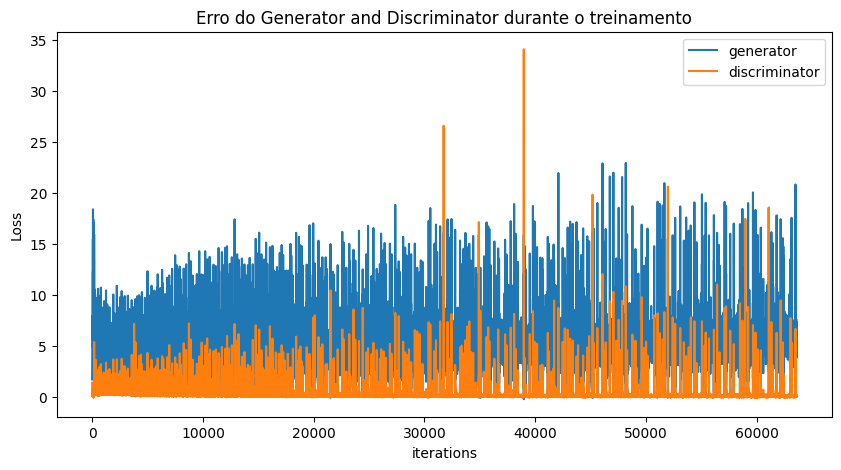

In [18]:
plt.figure(figsize=(10,5))
plt.title("Erro do Generator and Discriminator durante o treinamento")

plt.plot(G_losses, label="generator")
plt.plot(D_losses, label="discriminator")

plt.xlabel("iterations")
plt.ylabel("Loss")

plt.legend()
plt.show()

In [21]:
images = {}
for epoch in range(0, num_epochs, 2):
    grid = [] 
    for i in range(64):
        grid.append(read_image(f'./images/{epoch}/{i}.png'))
    images[epoch] = make_grid(grid, padding=2)

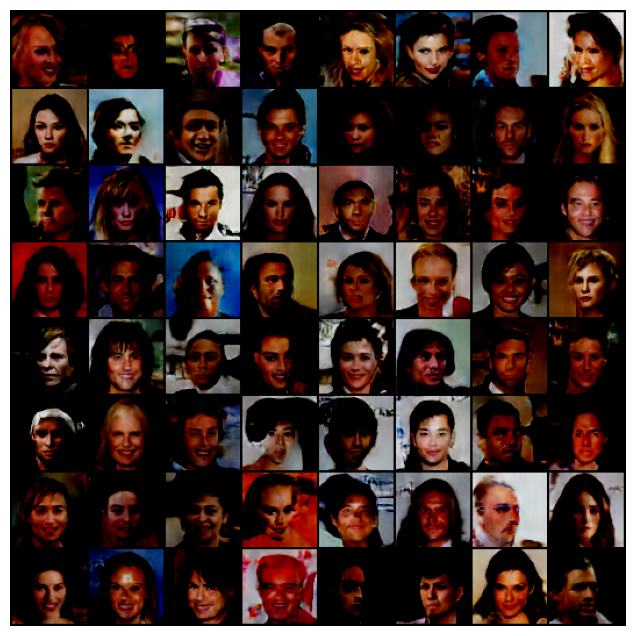

In [22]:
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(transforms.ToPILImage()(grid), animated=True)] for grid in images.values()]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [26]:
ani.save('./images/animation.gif', writer=animation.PillowWriter(fps=2))

In [27]:
torch.save(generator.state_dict(), 'generator_weights')
torch.save(discriminator.state_dict(), 'discriminator_weights')